# European Working Conditions Survey unsupervised method

**Task:** <br>
Understand European's life and work conditions based on unsupervised PCA and clustering techniques.
<br><br>

## Description for the EWCS dataset<br>
Q2a - Gender (Values 1: Male 2: Female)<br>

Q2b - Age (Values numeric)<br>
<br>
Q87a - I have felt cheerful and in good spirits (...which is the closest to how you have been feeling over the last two weeks)<br>
Q87b - I have felt calm and relaxed (...which is the closest to how you have been feeling over the last two weeks)<br>
Q87c - I have felt active and vigorous (...which is the closest to how you have been feeling over the last two weeks)<br>
Q87d - I woke up feeling fresh and rested (...which is the closest to how you have been feeling over the last two weeks)<br>
Q87e - My daily life has been filled with things that interest me (...which is the closest to how you have been feeling over the last two weeks)<br>

Values for variables Q87a to Q87e
* 1: All of the time.
* 2: Most of the time
* 3: More than half of the time
* 4: Less than half of the time
* 5: Some of the time
* 6: At no time

Q90a - At my work I feel full of energy (Please tell me how often you feel this way...)<br>
Q90b - I am enthusiastic about my job (Please tell me how often you feel this way...)<br>
Q90c - Time flies when I am working (Please tell me how often you feel this way...)<br>
Q90f - In my opinion, I am good at my job  (Please tell me how often you feel this way...)<br>

Values for variables Q90a to Q90f
* 1: Always.
* 2: Most of the time
* 3: Sometimes 
* 4: Rarely
* 5: Never

<br>
Source:
European Working Conditions Survey 2016.

## Importing libraries and reading CSV file

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv('EWCS_2016.csv')
df.head()

,Q2a,Q2b,Q87a,Q87b,Q87c,Q87d,Q87e,Q90a,Q90b,Q90c,Q90f
0,1,63,3,3,3,3,3,2,2,2,2
1,2,58,2,3,2,3,2,2,3,2,2
2,2,32,2,2,3,2,3,2,2,2,2
3,1,35,3,2,2,2,3,2,2,2,2
4,2,27,2,2,3,3,2,2,4,2,2


In [3]:
print('Number of rows:', len(df))

Number of rows: 7813


## Checking of data type

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7813 entries, 0 to 7812
Data columns (total 11 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   Q2a     7813 non-null   int64
 1   Q2b     7813 non-null   int64
 2   Q87a    7813 non-null   int64
 3   Q87b    7813 non-null   int64
 4   Q87c    7813 non-null   int64
 5   Q87d    7813 non-null   int64
 6   Q87e    7813 non-null   int64
 7   Q90a    7813 non-null   int64
 8   Q90b    7813 non-null   int64
 9   Q90c    7813 non-null   int64
 10  Q90f    7813 non-null   int64
dtypes: int64(11)
memory usage: 671.5 KB


## Checking for erroneous data
* checking unique values of each data
* checking min & max of numerical data

In [5]:
for col in df.columns:
    print(col, df[col].unique())
# there are some error data (-999) in all cols

Q2a [   1    2 -999]
Q2b [  63   58   32   35   27   19   23   24   22   54   38   41   45   28
   40   25   57   55   18   50   43   30   20   34   51   33   21   47
   37   29   49   53   48   44   56   26   60   36   46   52   31   61
   82   39   72   42   59   66   78   64   69   70 -999   73   65   62
   79   68   67   85   76   75   74   81   80   77   71   87   17   15
   16   84   86   83]
Q87a [   3    2    5    4    1    6 -999]
Q87b [   3    2    4    5    1    6 -999]
Q87c [   3    2    1    4    5    6 -999]
Q87d [   3    2    4    5    6    1 -999]
Q87e [   3    2    4    5    1    6 -999]
Q90a [   2    1    3    4    5 -999]
Q90b [   2    3    4    1    5 -999]
Q90c [   2    3    1    4 -999    5]
Q90f [   2    1    3 -999    4    5]


In [6]:
print('Q2b min', df['Q2b'].describe()['min'])
print('Q2b max', df['Q2b'].describe()['max'])

Q2b min -999.0
Q2b max 87.0


#### Q2b min is too erroneous, similar to other Questions

In [7]:
print("\033[4mNumber of -999 in each col\033[0m")
for col in df.columns:
    print(col, ":", df[df[col]==-999]['Q2a'].count())
# count number of -999 in each col

Number of -999 in each col
Q2a : 1
Q2b : 11
Q87a : 28
Q87b : 25
Q87c : 28
Q87d : 26
Q87e : 46
Q90a : 32
Q90b : 32
Q90c : 26
Q90f : 74


In [8]:
num_neg_infinity = df[df.sum(axis=1) < 0]['Q2a'].count()
print('Number of rows with -999 in at least 1 column:', num_neg_infinity)

Number of rows with -999 in at least 1 column: 166


In [9]:
print('Percentage of rows with -999:', round(num_neg_infinity*100/len(df),2),"%")

Percentage of rows with -999: 2.12 %


## Data Cleaning
* Drop all -999 rows

In [10]:
# drop rows with -999 as percentage of erroneous data is not high
df = df.drop(df[df.sum(axis=1) < 0].index)
print('New number of rows:', len(df))

New number of rows: 7647


In [11]:
# for unscaling MinMax of age in clustering
Q2b_min = df['Q2b'].describe().T['min']
Q2b_max = df['Q2b'].describe().T['max']
max_min_diff = Q2b_max - Q2b_min

In [12]:
print('Q2b min', df['Q2b'].describe()['min'])
print('Q2b max', df['Q2b'].describe()['max'])

Q2b min 15.0
Q2b max 87.0


## Exploratory Data Analytics

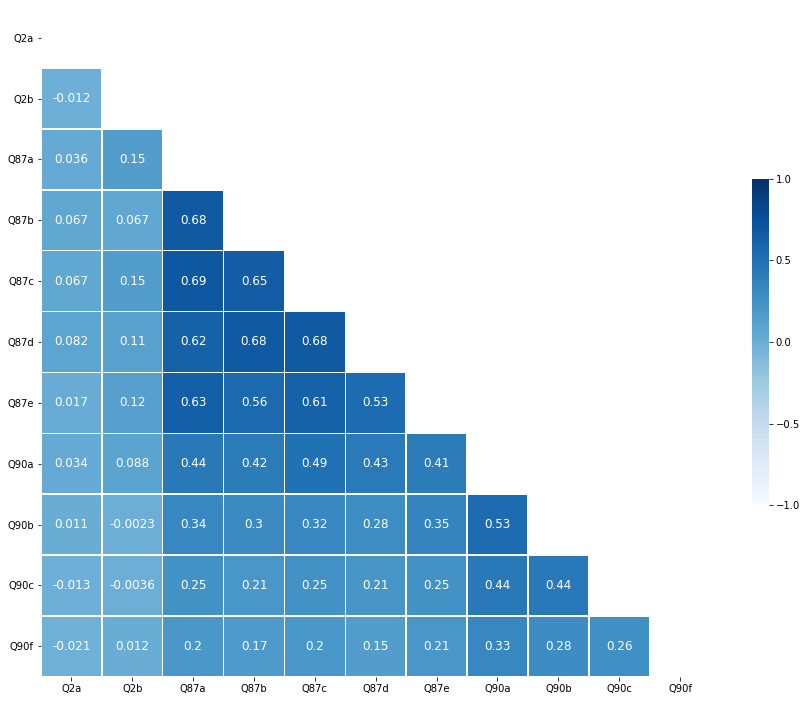

In [13]:
corr_matrix = df.corr()
mask = np.zeros_like(corr_matrix, dtype=np.bool)
mask[np.triu_indices_from(mask)]= True

f, ax = plt.subplots(figsize=(15, 15))

heatmap = sns.heatmap(corr_matrix,
                      mask = mask,
                      square = True,
                      linewidths = .5,
                      cmap= 'Blues',
                      cbar_kws = {'shrink': .4,
                                'ticks' : [-1, -.5, 0, 0.5, 1]},
                      vmin = -1,
                      vmax = 1,
                      annot = True,
                      annot_kws = {'size': 12})

#add the column names as labels
ax.set_yticklabels(corr_matrix.columns, rotation = 0)
ax.set_xticklabels(corr_matrix.columns)

sns.set_style({'xtick.bottom': True}, {'ytick.left': True})

### Observation
* All Q87 are moderate correlated to each other - This shows that individual’s life fulfilment tends to be holistic and covers a wide spectrum of their life. It is unlikely that an individual will feel fulfilled in only one segment of life.
* Q90a is moderately positiviely correlated to Q90b - signifying that individual’s energy level at work is related to how enthusiastic they are about work.
* Q90c - weak correlation with Q90a and Q90b
* Q90f - weak correlation with Q90a

array([[<AxesSubplot:title={'center':'Q2a'}>,
        <AxesSubplot:title={'center':'Q2b'}>,
        <AxesSubplot:title={'center':'Q87a'}>],
       [<AxesSubplot:title={'center':'Q87b'}>,
        <AxesSubplot:title={'center':'Q87c'}>,
        <AxesSubplot:title={'center':'Q87d'}>],
       [<AxesSubplot:title={'center':'Q87e'}>,
        <AxesSubplot:title={'center':'Q90a'}>,
        <AxesSubplot:title={'center':'Q90b'}>],
       [<AxesSubplot:title={'center':'Q90c'}>,
        <AxesSubplot:title={'center':'Q90f'}>, <AxesSubplot:>]],
      dtype=object)

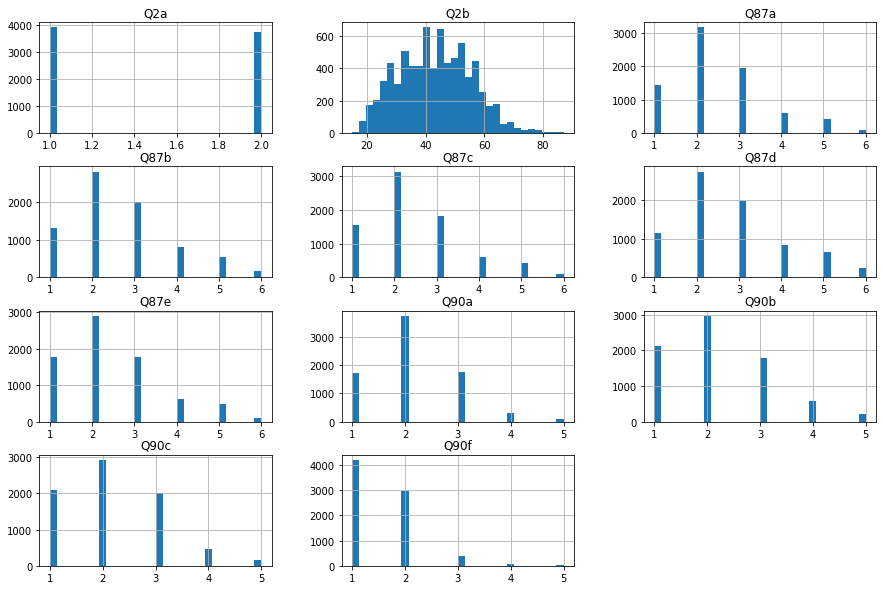

In [14]:
df.hist(bins=30, figsize=(15, 10))

### Observation
* Similar number of male and females
* Ages of individuals seem to follow a right skewed normal distribution, peaking at around 40-45
* For Q87a-Q90c, option 2 (most of the time) is the most common option - Individuals are generally satisfied at work and life
* For Q90f, option 1 (Always) is the most common option - Individuals generally feel that they are good at their job 

## Checking for skewness for numerical data

In [15]:
print('Skewness of Q2b:', df['Q2b'].skew())

Skewness of Q2b: 0.2043939205307917


#### Skewness of Q2b is low, no additional transformation is required

## MinMax scale data 
To reduce the impact of high magnitude feautures on the clustering Euclidean distance, we will scale all data to ensure that the magnitude of all features are the same.

In [16]:
from sklearn.preprocessing import MinMaxScaler
mm = MinMaxScaler()
for col in df.columns:
    df[col] = mm.fit_transform(df[[col]])

In [17]:
df.head()

,Q2a,Q2b,Q87a,Q87b,Q87c,Q87d,Q87e,Q90a,Q90b,Q90c,Q90f
0,0.0,0.666667,0.4,0.4,0.4,0.4,0.4,0.25,0.25,0.25,0.25
1,1.0,0.597222,0.2,0.4,0.2,0.4,0.2,0.25,0.50,0.25,0.25
2,1.0,0.236111,0.2,0.2,0.4,0.2,0.4,0.25,0.25,0.25,0.25
3,0.0,0.277778,0.4,0.2,0.2,0.2,0.4,0.25,0.25,0.25,0.25
4,1.0,0.166667,0.2,0.2,0.4,0.4,0.2,0.25,0.75,0.25,0.25


## Unsupervised PCA and Clustering Models 
* Principal Component Analysis
* K-means clustering
* Hierarchical agglomerative clustering (HAC)
* DBScan
* OPTICS

K-Means clustering and HAC have a predetermined number of clusters, while DBScan and OPTICS models will deduce the number of clusters based on the hyperparameters.

## Principal Component Analysis (PCA)

PCA is a dimension reduction tool that transforms data into a smaller dimension while capturing the maximum information (variance) of each feature.

* Explained variance of each PC
* PCA biplot - loading of each feature and feature correlations
* Feature importance in each PC

In [18]:
from sklearn.decomposition import PCA

pca_list = list()
feature_weight_list = list()

# Fit a range of PCA models

for n in range(1, 10):
    
    # Create and fit the model
    PCAmod = PCA(n_components=n)
    PCAmod.fit(df)
    
    # Store the model and variance
    pca_list.append(pd.Series({'n':n, 'model':PCAmod,
                               'var': PCAmod.explained_variance_ratio_.sum()}))
    
    # Calculate and store feature importances
    abs_feature_values = np.abs(PCAmod.components_).sum(axis=0)
    feature_weight_list.append(pd.DataFrame({'n':n, 
                                             'features': df.columns,
                                             'values':abs_feature_values/abs_feature_values.sum()}))

pca_var_df = pd.concat(pca_list, axis=1).T.set_index('n')
pca_var_df

,model,var
n,,
1,PCA(n_components=1),0.343187
2,PCA(n_components=2),0.648721
3,PCA(n_components=3),0.748795
4,PCA(n_components=4),0.793876
5,PCA(n_components=5),0.834433
6,PCA(n_components=6),0.87125
7,PCA(n_components=7),0.904191
8,PCA(n_components=8),0.932074
9,PCA(n_components=9),0.958345


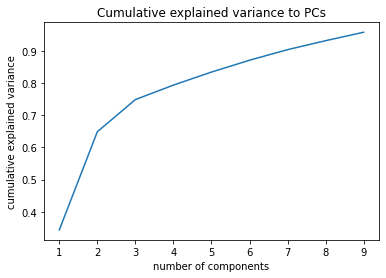

In [19]:
plt.plot(range(1,10), pca_var_df['var'])
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.title('Cumulative explained variance to PCs');

Despite the elbow(highest change in gradient) occuring at 2 PCs, we will select 3 PCs as the total cumulative explained variance is up to 75% while still significantly reducing the number of dimensions.

In [20]:
n_components = 3
pca = PCA(n_components=n_components)
pca_df = pca.fit_transform(df)

In [21]:
def myplot(score,coeff,labels=None):
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    plt.figure(figsize=(15, 10))
    plt.scatter(xs * scalex,ys * scaley,s=25, c='lightblue')
    for i in range(n):
        plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'red',alpha = 0.5)
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = 'green', ha = 'center', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.05, coeff[i,1]* 1.05, labels[i], color = 'darkgreen', ha = 'center', va = 'center', fontsize=20)
    plt.xlabel("PC{}".format(1), fontsize=20)
    plt.ylabel("PC{}".format(2), fontsize=20)
    
    plt.grid()

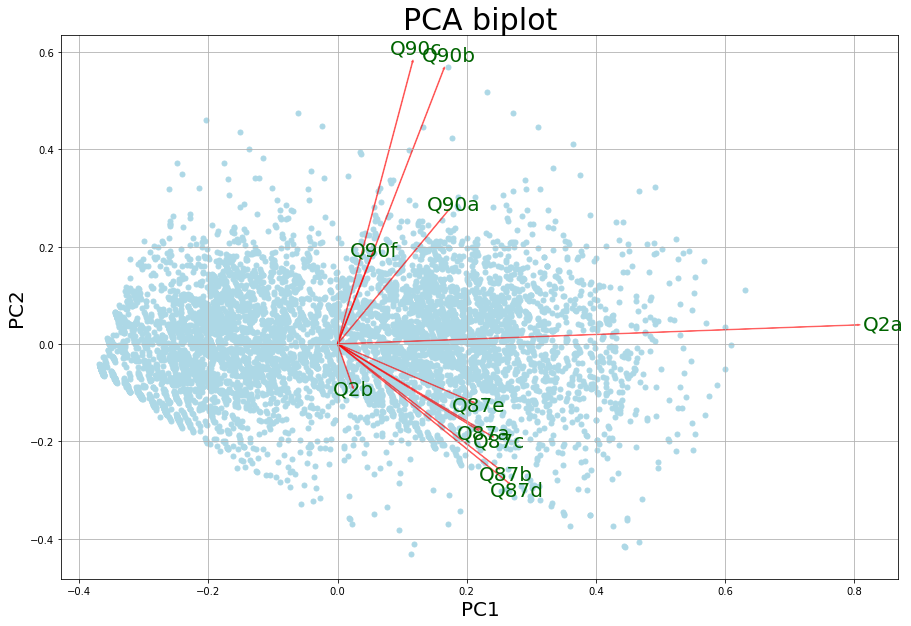

In [22]:
plot1 = [0,2]
myplot(pca_df[:,plot1],np.transpose(pca.components_[plot1,:]),list(df.columns))
plt.title('PCA biplot', fontsize = 30)
plt.show()

### Observation
* Q2a has the largest loading in PC1, Q2b has the smalles loading in PC1
* The biplot confirms that Q87 are positively correlated to each other. Likewise, Q90 is also positively correlated to each other
* There are some correlation between Q2b and Q87 - signifying that older individuals tend to feel more fulfiled in life
* As Q90 and Q87 are 90 degress apart, we can state that Q90 and Q87 are not correlated - no correlation between life fulfilment and job satisfaction

## PCA Feature importance

In [23]:
features_df = (pd.concat(feature_weight_list)
               .pivot(index='n', columns='features', values='values'))

features_df # how much each feature contribute to each component

features,Q2a,Q2b,Q87a,Q87b,Q87c,Q87d,Q87e,Q90a,Q90b,Q90c,Q90f
n,,,,,,,,,,,
1,0.320853,0.009283,0.085884,0.098904,0.094947,0.105418,0.083137,0.068381,0.065530,0.046206,0.021456
2,0.254635,0.012262,0.093782,0.102445,0.098978,0.106548,0.093773,0.075349,0.075996,0.058032,0.028200
3,0.174269,0.018847,0.083723,0.099172,0.088861,0.105574,0.076882,0.083504,0.119193,0.108964,0.041011
4,0.141337,0.016511,0.068947,0.085179,0.076318,0.102709,0.079630,0.073418,0.158237,0.160585,0.037130
5,0.116273,0.074392,0.064785,0.094602,0.068508,0.107492,0.095946,0.064875,0.140488,0.134092,0.038547
6,0.098761,0.096266,0.064089,0.079923,0.062732,0.115163,0.124998,0.076688,0.124964,0.122588,0.033827
7,0.086818,0.096399,0.057248,0.070266,0.058023,0.105904,0.113042,0.086898,0.128034,0.118677,0.078691
8,0.074971,0.094877,0.066209,0.090886,0.057862,0.111985,0.113222,0.091260,0.115455,0.105472,0.077801
9,0.066262,0.091262,0.068165,0.084643,0.061530,0.121021,0.105848,0.106891,0.110305,0.096015,0.088059


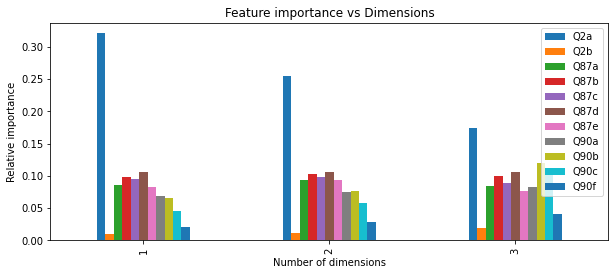

In [24]:
ax = features_df[0:3].plot(kind='bar', figsize=(10,4))
ax.legend(loc='upper right')
ax.set(xlabel='Number of dimensions',
       ylabel='Relative importance',
       title='Feature importance vs Dimensions');

** Observation **
* Qn2a has the greatest feature importance in PC1 - PC3.
* Q2b has relatively low feature importance across PC1 - PC4.
* Q90b and Q90c have high feature importance in PC4 and PC5.
* Q90f has low feature importance across all PCs.

## Model visualizations evaluation

In [25]:
# function for jitter scatter plot for clustering visuals
def rand_jitter(arr):
    stdev = .01 * (max(arr) - min(arr))
    return arr + np.random.randn(len(arr)) * stdev

def jitter(x, y, s=20, c='b', marker='o'):
    from matplotlib.colors import ListedColormap
    scatter = plt.scatter
    colours = ListedColormap(['r','b','g','y'])
    plt.figure(figsize=(5,2))
    return scatter(rand_jitter(x), rand_jitter(y), s=s, c=c, marker=marker, alpha=0.5,cmap=colours)

In [26]:
from timeit import default_timer as timer # Calcuate time elapsed in training model

## K Means Clustering
This clustering method takes a user input K as the number of clusters and create clusters based on Euclidean distances.<br>The following are the steps that the K means model takes to cluster the datapoints, 

1. The model initializes K number of centroids randomly in the data
2. The Euclidean distance between the datapoints and clusters are calculated. Each datapoint will be assigned as the same cluster as the closest centroid
3. The centroid is relocated to the centre of the cluster
4. Step 2 and 3 are repeated until the maximum iterations is reached or if the changes are too small


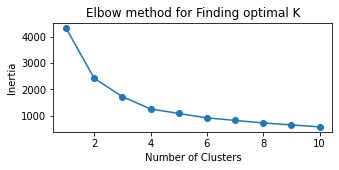

In [27]:
from sklearn.cluster import KMeans

inertia = [] # inertia is the 
list_num_clusters = list(range(1,11))
for num_clusters in list_num_clusters:
    km = KMeans(n_clusters=num_clusters)
    km.fit(pca_df)
    inertia.append(km.inertia_)

plt.figure(figsize=(5,2))   
plt.plot(list_num_clusters,inertia)
plt.scatter(list_num_clusters,inertia)
plt.title('Elbow method for Finding optimal K')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia');

To determine the optimal number of clusters, we utilize the inertia to the number of clusters plot. Using the elbow method, we would select 4 clusters to minimize the number of clusters while ensuring that subsequent changes in inertia are not as significant.  

In [28]:
start = timer()

num_clusters = 4
km = KMeans(n_clusters=num_clusters,random_state=24,n_init=3) # n_init, number of times the K-mean algorithm will run
km.fit(pca_df)
df['k_means'] = km.predict(pca_df)

end = timer()
k_means_time = end - start
print('Time Elapsed (sec):', k_means_time)

Time Elapsed (sec): 0.13775550000002568


Text(0, 0.5, 'Enthusiasm')

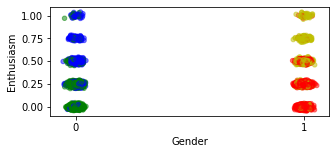

In [29]:
jitter(x=rand_jitter(df['Q2a']), y=rand_jitter(df['Q90a']),c=df['k_means'])
plt.xticks([0, 1])
plt.xlabel('Gender')
plt.ylabel('Enthusiasm')

We observe 4 distinct clusters by color that are defined by their gender and their work enthusiasm level.

In [30]:
clusters = [0,1,2,3]

number_of_individuals = []
for clus in clusters:
     count = df[df['k_means'] == clus]['Q2a'].count()
     number_of_individuals.append(count)

proportion_of_male = []
for clus in clusters:
     proportion = df[df['k_means'] == clus]['Q2a'].mean()
     proportion_of_male.append(proportion)

average_age = []
for clus in clusters:
     avg = df[df['k_means'] == clus]['Q2b'].mean()
     avg = (avg*max_min_diff)+Q2b_min
     average_age.append(avg)

avg_Q87a = []
for clus in clusters:
     avg = df[df['k_means'] == clus]['Q87a'].mean()
     avg = avg*6
     avg_Q87a.append(avg)

avg_Q90a = []
for clus in clusters:
     avg = df[df['k_means'] == clus]['Q90a'].mean()
     avg = avg*5
     avg_Q90a.append(avg)

In [31]:
pd.DataFrame({'Number of individuals': number_of_individuals, 'Proportion of males': proportion_of_male, 'Average age':average_age, 'avg Q87a':avg_Q87a, 'avg Q90a':avg_Q90a}, index=[1,2,3,4]).rename_axis("Cluster", axis=1)

Cluster,Number of individuals,Proportion of males,Average age,avg Q87a,avg Q90a
1,2380,1.0,41.695378,1.051261,1.003151
2,1396,0.0,44.815903,2.727507,2.105122
3,2503,0.0,42.470236,1.071994,0.964842
4,1368,1.0,45.281433,2.992982,2.211257


### Understanding the clusters
### Gender (Q2a)
Clusters 1 and 4 are the clusters with only males, while cluster 2 and 3 only have females.

### Average age (Q2b), life fulfilment (Q87a) and work enthusiasm (Q90a)
Further splitting the male cluster, cluster 1 consist of younger males who are very enthusiastic about life and work. Cluster 4 consist of older males who are slightly less enthusiastic about life and work.<br> 
Likewise, the female clusters are split into cluster 2 and 3, where cluster 3 are younger females who are very enthusiastic about life and work. Cluster 3 are slightly older females who are slightly less enthusiastic about life and work.As seen in the above gender to enthusiasm (Q90a) scatter plot, we observe 4 distinct clusters by colour that are defined by their gender and their work enthusiasm level. 


## Hierarchical Agglomerative Clustering Model

This algorithm fuses the closest (Euclidean distance) 2 datapoints/cluster into the same cluster, the fusing is repeated until all datapoints are in the same cluster. 

In [32]:
from sklearn.cluster import AgglomerativeClustering

start = timer()
num_clusters = 4
ag = AgglomerativeClustering(n_clusters=num_clusters, linkage='ward', compute_full_tree=True)
ag = ag.fit(pca_df)
df['agglom'] = ag.fit_predict(pca_df)

end = timer()
HAC_time = end - start
print('Time Elapsed (sec):', HAC_time)    

Time Elapsed (sec): 19.64908300000002


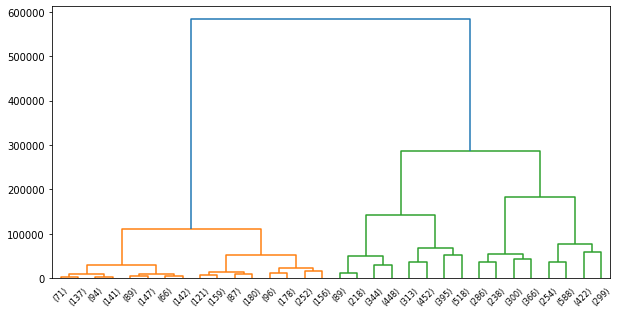

In [33]:
from scipy.cluster import hierarchy

Z = hierarchy.linkage(ag.children_, method='ward')
fig, ax = plt.subplots(figsize=(10,5))

den = hierarchy.dendrogram(Z, orientation='top', 
                           p=4, truncate_mode='level', # p=30, truncate_mode='lastp'
                           show_leaf_counts=True, ax=ax)

Text(0.5, 1.0, 'HAC clustering')

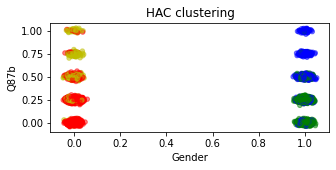

In [35]:
jitter(x=rand_jitter(df['Q2a']), y=rand_jitter(df['Q90a']),c=df['agglom'])
plt.xlabel('Gender')
plt.ylabel('Q87b')
plt.title('HAC clustering')

In [36]:
clusters = [0,1,2,3]

number_of_individuals = []
for clus in clusters:
     count = df[df['agglom'] == clus]['Q2a'].count()
     number_of_individuals.append(count)

proportion_of_male = []
for clus in clusters:
     proportion = df[df['agglom'] == clus]['Q2a'].mean()
     proportion_of_male.append(proportion)

average_age = []
for clus in clusters:
     avg = df[df['agglom'] == clus]['Q2b'].mean()
     avg = (avg*max_min_diff)+Q2b_min
     average_age.append(avg)

avg_Q87a = []
for clus in clusters:
     avg = df[df['agglom'] == clus]['Q87a'].mean()
     avg = avg*6
     avg_Q87a.append(avg)

avg_Q90a = []
for clus in clusters:
     avg = df[df['agglom'] == clus]['Q90a'].mean()
     avg = avg*5
     avg_Q90a.append(avg)

In [37]:
pd.DataFrame({'Number of individuals': number_of_individuals, 'Proportion of males': proportion_of_male, 'Average age':average_age, 'avg Q87a':avg_Q87a, 'avg Q90a':avg_Q90a}, index=[1,2,3,4]).rename_axis("Cluster", axis=1)

Cluster,Number of individuals,Proportion of males,Average age,avg Q87a,avg Q90a
1,3154,0.0,42.963221,1.329740,1.096227
2,1472,1.0,45.099864,2.903804,2.168818
3,2276,1.0,41.648946,1.020211,0.975395
4,745,0.0,44.778523,3.082953,2.545302


In [38]:
# Comparing with KMeans results:
(df[['agglom','k_means']]
 .groupby(['agglom','k_means'])
 .size()
 .to_frame()
 .rename(columns={0:'count'}))

count
agglom k_means       
0      1          655
       2         2499
1      0          105
       3         1367
2      0         2275
       3            1
3      1          741
       2            4

Observing the table above, we notice that HAC cluster 0 and 3 are similar to K means cluster 1 and 2. Similarly,  HAC cluster 1 and 2 are similar to K means cluster 0 and 3.

Based on proportions, both HAC cluster 2 and 3 are about the same as k means cluster 0 and 2 respectively.  

## DBScan Clustering

Unlike K Means clustering and HAC, DBScan determines the number of clusters based on specified hyperparameters. DBScan is a density-based algorithm that relies on neighborhood size to determine the number of clusters, cluster a point if it is close to other points from the same cluster.

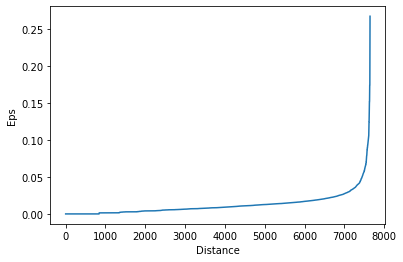

In [39]:
from sklearn.neighbors import NearestNeighbors
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(pca_df)
distances, indices = nbrs.kneighbors(pca_df)

distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.ylabel('Eps')
plt.xlabel('Distance')
plt.plot(distances)

Plotting the Eps to distance, we can find the optimal Eps value at the point of curvature, such that distance between clusters do not exponentially increase. 
However, as the density of the chart is uneven, a Eps that is too low will create too many clusters in the less dense areas. 
<br>For the purpose of demostration, we will have 2 models of different Eps - DBScan_optimized: 0.05 and DBScan_optimized: 0.2

In [40]:
from sklearn.cluster import DBSCAN
from collections import Counter

num_clusters = []
min_samples = []
for min_sam in range(0,75):
    min_samples.append(min_sam)
    dbscan = DBSCAN(eps=0.2, min_samples=min_sam, metric='euclidean')
    num_clus = len(Counter(dbscan.fit_predict(pca_df)))
    num_clusters.append(num_clus)

min_sam_clust = pd.DataFrame({'Min Samples':min_samples, 'Number of clusters':num_clusters})

Text(0, 0.5, 'Number of clusters')

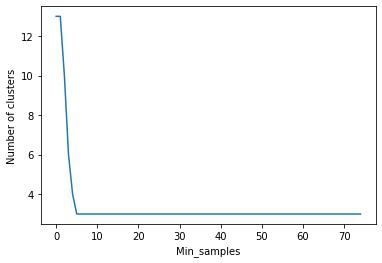

In [41]:
plt.plot(min_sam_clust['Min Samples'], min_sam_clust['Number of clusters'])
plt.xlabel('Min_samples')
plt.ylabel('Number of clusters')

The above graph shows that the min_samples will determine the number of clusters, determining the number of points that will become core points and border points. The higher the min_sample, the lesser core points, thus a fall in number of clusters.

However we are not able to determine the optimal min_sample as it is a case by case basis, with domain knowledge being the best estimator of min_sample. As such, we would use min_sample = 20 as a default.

In [42]:
dbscan = DBSCAN(eps=0.05, min_samples=20, metric='euclidean')
df['DBScan_unoptimized'] = dbscan.fit_predict(pca_df)
print('Number of clusters:', df['DBScan_unoptimized'].nunique())

Number of clusters: 20


In [43]:
start = timer()
dbscan = DBSCAN(eps=0.2, min_samples=20, metric='euclidean')
df['DBScan_optimized'] = dbscan.fit_predict(pca_df)
print('Number of clusters:', df['DBScan_optimized'].nunique())

end = timer()
DBScan_time = end - start
print('Time Elapsed (sec):', DBScan_time)

Number of clusters: 3
Time Elapsed (sec): 0.45378929999998263


Text(0.5, 1.0, 'DBScan - Eps = 0.2')

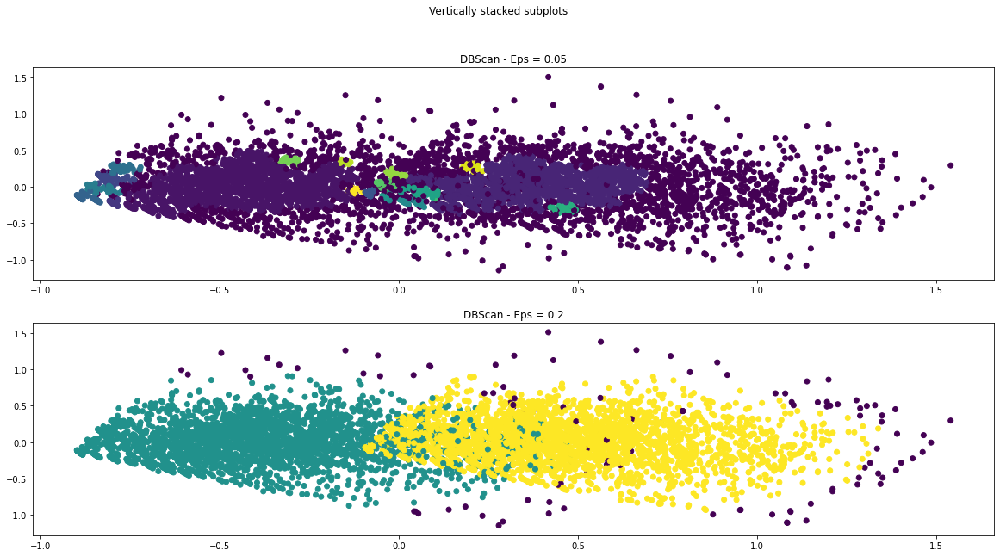

In [44]:
fig, axs = plt.subplots(2, figsize=(20,10))
fig.suptitle('Vertically stacked subplots')
axs[0].scatter(x=pca_df[:,0], y=pca_df[:,2], c=df['DBScan_unoptimized'])
axs[0].set_title('DBScan - Eps = 0.05')
axs[1].scatter(x=pca_df[:,0], y=pca_df[:,2], c=df['DBScan_optimized'])
axs[1].set_title('DBScan - Eps = 0.2')

The DBScan model with too low Eps (Eps=0.05) produces an overwhelming cluster and too many small clusters.
<br> The DBScan model with higher Eps (Eps=0.2) generates a better model, with a clear distinction in the clusters.

In [45]:
clusters = [0,1,-1]

number_of_individuals = []
for clus in clusters:
     count = df[df['DBScan_optimized'] == clus]['Q2a'].count()
     number_of_individuals.append(count)

proportion_of_male = []
for clus in clusters:
     proportion = df[df['DBScan_optimized'] == clus]['Q2a'].mean()
     proportion_of_male.append(proportion)

average_age = []
for clus in clusters:
     avg = df[df['DBScan_optimized'] == clus]['Q2b'].mean()
     avg = (avg*max_min_diff)+Q2b_min
     average_age.append(avg)

avg_Q87a = []
for clus in clusters:
     avg = df[df['DBScan_optimized'] == clus]['Q87a'].mean()
     avg = avg*6
     avg_Q87a.append(avg)

avg_Q90a = []
for clus in clusters:
     avg = df[df['DBScan_optimized'] == clus]['Q90a'].mean()
     avg = avg*5
     avg_Q90a.append(avg)

In [46]:
pd.DataFrame({'Number of individuals': number_of_individuals, 'Proportion of males': proportion_of_male, 'Average age':average_age, 'avg Q87a':avg_Q87a, 'avg Q90a':avg_Q90a}, index=[1,2,3]).rename_axis("Cluster", axis=1)

Cluster,Number of individuals,Proportion of males,Average age,avg Q87a,avg Q90a
1,3843,0.000000,43.321103,1.631538,1.342050
2,3691,1.000000,42.996749,1.719209,1.409848
3,113,0.504425,43.026549,4.173451,3.584071


### Understanding the clusters

DBScan identified 3 clusters based on the specified hyperparameters (epsilon and min sample).

### Average life fulfilment and work enthusiasm 
Cluster 3 are individuals who find less fulfilment in life and less enthusiasm in work; cluster consists of an even split of males and females. Cluster 1 is the females who are very enthusiastic about life and work and cluster 2 are males who are very enthusiastic about life and work.


Text(0.5, 1.0, 'DBScan clustering')

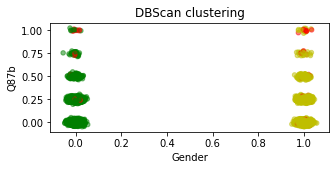

In [47]:
jitter(x=rand_jitter(df['Q2a']), y=rand_jitter(df['Q90f']),c=df['DBScan_optimized'])
plt.xlabel('Gender')
plt.ylabel('Q87b')
plt.title('DBScan clustering')

DBScan model automatically decides the number of clusters based on the the parameters, therefore useful in situations where we are unsure of the number of clusters in the data. Since there are no prior known number of clusters, DBScan will be useful in clustering based on euclidean distance instead of a user determined number of cluster.

However, DBScan is sensitive to density, thus the above scatter plot does not form the appropriate clusters. A higher Eps value will aid in overcoming the density variation.

## OPTICS Clustering

In [48]:
from sklearn.cluster import OPTICS, cluster_optics_dbscan 

start = timer()
opt = OPTICS(min_samples=10, xi=.02, min_cluster_size=0.1)
df['optics'] = opt.fit_predict(pca_df)

end = timer()
OPTICS_time = end - start
print('Time Elapsed (sec):', OPTICS_time)
print('Numbe of clusters:',df['optics'].nunique())

Time Elapsed (sec): 20.44197299999996
Numbe of clusters: 3


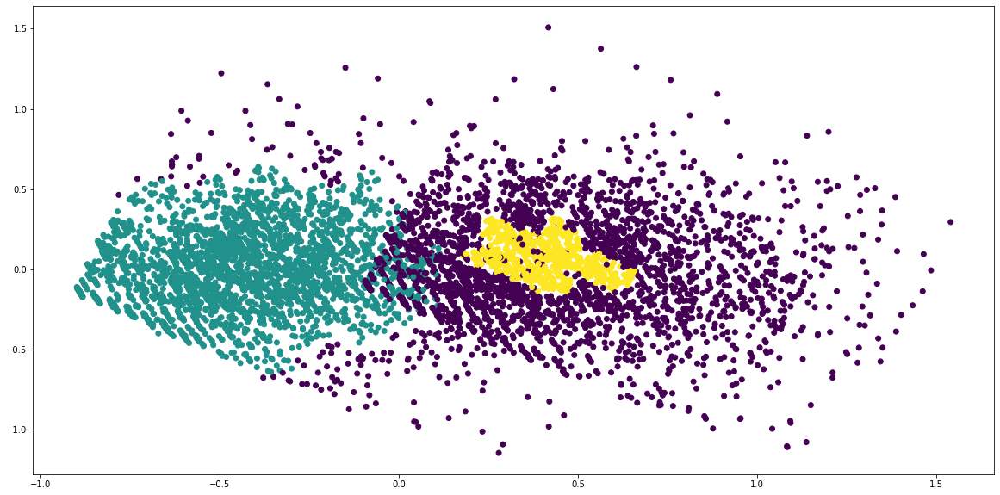

In [49]:
plt.figure(figsize=(20,10))
plt.scatter(x=pca_df[:,0], y=pca_df[:,2], c=df['optics'])

In [50]:
labels1 = df['DBScan_optimized']
labels2 = df['DBScan_unoptimized']
# Creating a numpy array with numbers at equal spaces till 
# the specified range 
space = np.arange(len(pca_df)) 
  
# Storing the reachability distance of each point 
reachability = opt.reachability_[opt.ordering_] 
  
# Storing the cluster labels of each point 
labels = opt.labels_[opt.ordering_] 

In [52]:
clusters = [0,1,-1]

number_of_individuals = []
for clus in clusters:
     count = df[df['optics'] == clus]['Q2a'].count()
     number_of_individuals.append(count)

proportion_of_male = []
for clus in clusters:
     proportion = df[df['optics'] == clus]['Q2a'].mean()
     proportion_of_male.append(proportion)

average_age = []
for clus in clusters:
     avg = df[df['optics'] == clus]['Q2b'].mean()
     avg = (avg*max_min_diff)+Q2b_min
     average_age.append(avg)

avg_Q87a = []
for clus in clusters:
     avg = df[df['optics'] == clus]['Q87a'].mean()
     avg = avg*6
     avg_Q87a.append(avg)

avg_Q90a = []
for clus in clusters:
     avg = df[df['optics'] == clus]['Q90a'].mean()
     avg = avg*5
     avg_Q90a.append(avg)

In [53]:
pd.DataFrame({'Number of individuals': number_of_individuals, 'Proportion of males': proportion_of_male, 'Average age':average_age, 'avg Q87a':avg_Q87a, 'avg Q90a':avg_Q90a}, index=[1,2,3]).rename_axis("Cluster", axis=1)

Cluster,Number of individuals,Proportion of males,Average age,avg Q87a,avg Q90a
1,3534,0.000000,42.991228,1.472326,1.253891
2,962,1.000000,42.504158,1.558004,1.413721
3,3151,0.884164,43.549984,2.026404,1.578864


The OPTICS models does not seems to produce any distinct clusters, thus we would not really consider this model for this project.

## Elapsed time of all models

In [55]:
time_elapsed = [k_means_time, HAC_time, DBScan_time, OPTICS_time]

labels = ['k means', 'HAC', 'DBScan', 'OPTICS']

eval_df = pd.DataFrame({'Time Elapsed':time_elapsed},index=labels)
eval_df

,Time Elapsed
k means,0.137756
HAC,19.649083
DBScan,0.453789
OPTICS,20.441973


Text(0.5, 1.0, 'OPTICS - PC1 and PC3')

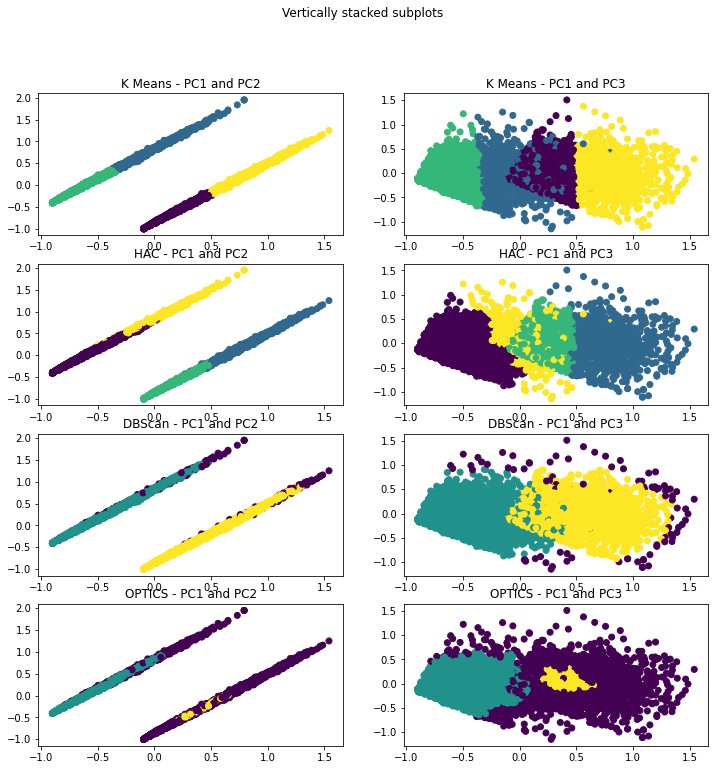

In [60]:
fig, axs = plt.subplots(4,2,figsize=(12,12))
fig.suptitle('Vertically stacked subplots')
axs[0,0].scatter(x=pca_df[:,0], y=pca_df[:,1], c=df['k_means'])
axs[0,0].set_title('K Means - PC1 and PC2')
axs[0,1].scatter(x=pca_df[:,0], y=pca_df[:,2], c=df['k_means'])
axs[0,1].set_title('K Means - PC1 and PC3')
axs[1,0].scatter(x=pca_df[:,0], y=pca_df[:,1], c=df['agglom'])
axs[1,0].set_title('HAC - PC1 and PC2')
axs[1,1].scatter(x=pca_df[:,0], y=pca_df[:,2], c=df['agglom'])
axs[1,1].set_title('HAC - PC1 and PC3')
axs[2,0].scatter(x=pca_df[:,0], y=pca_df[:,1], c=df['DBScan_optimized'])
axs[2,0].set_title('DBScan - PC1 and PC2')
axs[2,1].scatter(x=pca_df[:,0], y=pca_df[:,2], c=df['DBScan_optimized'])
axs[2,1].set_title('DBScan - PC1 and PC3')
axs[3,0].scatter(x=pca_df[:,0], y=pca_df[:,1], c=df['optics'])
axs[3,0].set_title('OPTICS - PC1 and PC2')
axs[3,1].scatter(x=pca_df[:,0], y=pca_df[:,2], c=df['optics'])
axs[3,1].set_title('OPTICS - PC1 and PC3')

Based on the 4 clustering models, we observe 2 very different clusters. Both clusters will be very useful in different scenarios; the K means and HAC cluster will be useful when considering gender and age as a major factor while the DBScan only have 3 clusters, taking enthusiasm level in work and life as a major factor.<br><br>
The common trait between both models is to split the gender and enthusiasm level, implying that both these 2 features are significant factors in splitting into well-defined clusters.

## Thank you for reviewing!